# Big Data elemzési módszerek házi feladat

Feladatunk a Global Terrorism Database által szolgáltatott terrorcselekményekre vonatkozó adatok elemzése.

## Adatok betöltése, adattisztítás

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import pyspark
from pyspark.sql.functions import desc
from pyspark.sql.types import IntegerType
from pyspark.sql.types import DoubleType

sc = pyspark.SparkContext()
spark = pyspark.SQLContext(sc)

_.xlsx_ fájlból való olvasást nem tudtuk megoldani, így ezt csv-re konvertáltuk.

In [2]:
df = spark.read\
    .format("csv")\
    .option("header", "true")\
    .option("inferSchema", "true")\
    .option("treatEmptyValuesAsNulls", "true") \
    .option("delimiter", '|')\
    .load("./gterror.csv")

In [3]:
df.printSchema()

root
 |-- _c0: integer (nullable = true)
 |-- eventid: long (nullable = true)
 |-- iyear: integer (nullable = true)
 |-- imonth: integer (nullable = true)
 |-- iday: integer (nullable = true)
 |-- approxdate: string (nullable = true)
 |-- extended: integer (nullable = true)
 |-- resolution: timestamp (nullable = true)
 |-- country: integer (nullable = true)
 |-- country_txt: string (nullable = true)
 |-- region: integer (nullable = true)
 |-- region_txt: string (nullable = true)
 |-- provstate: string (nullable = true)
 |-- city: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- specificity: double (nullable = true)
 |-- vicinity: integer (nullable = true)
 |-- location: string (nullable = true)
 |-- summary: string (nullable = true)
 |-- crit1: integer (nullable = true)
 |-- crit2: integer (nullable = true)
 |-- crit3: integer (nullable = true)
 |-- doubtterr: double (nullable = true)
 |-- alternative: double (nullable = tru

A spark által feltételezett sémát összehasonlítva az adathalmazhoz tartozó magyarázó pdf-el, azt vettük észre, hogy két oszlop nem megfelelő típusú:
* INT_LOG
* INT_IDEO

Ennek oka, eredhet a konverzióból, de lehet hogy már az xlsx fájl is hibás volt. Mindenesetre meg kell viszgálni ezeket az oszlopokat.

In [4]:
df.select("INT_IDEO") \
    .rdd \
    .filter(lambda x: (x["INT_IDEO"] is not None) and not(str(x["INT_IDEO"]).replace("-","").isnumeric())) \
    .toDF() \
    .groupBy("INT_IDEO") \
    .count() \
    .toPandas() \

,INT_IDEO,count
0,START Primary Collection,6


Megnéztük milyen és hány darab nem numerikus érték szerepel. Látszik, hogy a "START Primary Collection" értékből 6db van, ami gyanúsan egy másik mező értéke. Ez arra enged következtetni, hogy az egész sor rossz értékeket tartalmaz. Mivel csak hat sorról van szó, ami a teljes adathalazhoz képes elenyésző, ezen sorok elhagyhatók.

In [5]:
df.select("INT_LOG") \
    .rdd \
    .filter(lambda x: (x["INT_LOG"] is not None) and not(str(x["INT_LOG"]).replace("-","").isnumeric())) \
    .toDF() \
    .groupBy("INT_LOG") \
    .count() \
    .toPandas() \

,INT_LOG,count
0,Hewitt Project,1
1,"""""""Blast kills al-Madaen Sahwa leader,"""" Al-Sh...",1
2,"""""""Egyptian trade union says members were kidn...",1
3,"Rocket from Gaza hits Israel; no injuries,"""" ...",1
4,START Primary Collection,149
5,CETIS,1
6,"""""""Libya Daily Digest February 23, 2016,"""" Lib...",1
7,"Cairo Post,"""" The Cairo Post, June 1, 2014.""",1


Megvizsgálva az INT_LOG oszlopot, itt már 156 hibás értékkel találkozunk. Ezen sorokat szintén elhagyjuk.

In [6]:
schema = df.schema
def is_number(value):
    return str(value).replace("-","").isnumeric()

df_clean = df.rdd \
    .filter(lambda x: ((x["INT_LOG"] is None) or is_number(x["INT_LOG"])) and (x["INT_IDEO"] is None or is_number(x["INT_IDEO"]))) \
    .toDF(schema)

In [7]:
all_rows = df.count()
lost_rows = all_rows-df_clean.count()
ratio = str(round((lost_rows/all_rows)*100,2))+"%"
print("{0} darab sort veszítettünk a {1} darab sorból ({2})".format(lost_rows,all_rows,ratio))

157 darab sort veszítettünk a 181691 darab sorból (0.09%)


A sorok eldobása után elvégezhető a konverzió int-re.

In [8]:
from pyspark.sql.functions import col
df_clean = df_clean \
    .withColumn("INT_LOG", col('INT_LOG').cast("int")) \
    .withColumn("INT_IDEO", col('INT_IDEO').cast("int"))
schema = df.schema

Szövegelemzéssel nem fogunk foglalkozni így a nem kategorikus szöveges adatok elhagyhatóak. 

In [9]:
numeric_columns = ["eventid", "iyear", "imonth", "iday", "latitude", "longitude","nperps","nperpcap","nkill","nkillus",
                   "nkillter","nwound","nwoundte","nwoundus","propvalue","nhostkid","nhostkidus","nhours","ndays","ransomamt","ransomamtus",
                   "ransompaid","ransompaidus","nreleased"]

catergorical_columns = ['extended','crit1','crit2','crit3','doubtterr','alternative','multiple','country','region','vicinity',
                        'specificity','attacktype1','attacktype2','attacktype3','success','suicide','weaptype1','weapsubtype1',
                        'weaptype2','weapsubtype2','weaptype3','weapsubtype3','weaptype4','weapsubtype4','targtype1',
                        'targsubtype1','natlty1','targtype2','targsubtype2','natlty2','targtype3','targsubtype3','natlty3',
                        'guncertain1','guncertain2','guncertain3','individual','claimed','claimmode','compclaim','claim2',
                        'claimmode2','claim3','claimmode3','property','propextent','ishostkid','ransom','hostkidoutcome',
                        'INT_LOG','INT_IDEO','INT_MISC','INT_ANY']
                       
categorical_text_columns= ['country_txt','region_txt','alternative_txt','attacktype1_txt','attacktype2_txt','attacktype3_txt',
                        'targtype1_txt','targsubtype1_txt','natlty1_txt','targtype2_txt','targsubtype2_txt','natlty2_txt',
                        'targtype3_txt','targsubtype3_txt','natlty3_txt','claimmode_txt','claimmode2_txt','claimmode3_txt',
                        'weaptype1_txt','weapsubtype1_txt','weaptype2_txt','weapsubtype2_txt','weaptype3_txt','weapsubtype3_txt',
                        'weaptype4_txt','weapsubtype4_txt','propextent_txt','hostkidoutcome_txt','gname']

text_columns = ['approxdate','summary','related','provstate','city','location','weapdetail','corp1','target1','corp2',
                'target2','corp3','target3','gsubname','gname2','gsubname2','gname3','gsubname3','motive','propcomment',
                'divert','kidhijcountry','ransomnote','addnotes','scite1','scite2','scite3','dbsource']

In [10]:
columns_to_keep = numeric_columns.copy()
columns_to_keep.extend(catergorical_columns)
columns_to_keep.extend(categorical_text_columns)
df_clean = df_clean.select(columns_to_keep)

## Felderítő adatelemzés
Következő lépés a feldereítő adatelemzés végrehajtása. Első lépésként megvizsgáltuk az adatkeret leíró statisztikáit. Ezeket csak a numerikus oszlopokon van értelme végrehajtani.

In [11]:
df_description = df_clean.select(numeric_columns).describe().toPandas()
old_max_columns = pd.options.display.max_columns
pd.options.display.max_columns = 140
df_description

,summary,eventid,iyear,imonth,iday,latitude,longitude,nperps,nperpcap,nkill,nkillus,nkillter,nwound,nwoundte,nwoundus,propvalue,nhostkid,nhostkidus,nhours,ndays,ransomamt,ransomamtus,ransompaid,ransompaidus,nreleased
0,count,181534,181534,181534,181534,176979,176978,110420,112046,171224,117088,114578,165234,112394,116832,38926,13560,13505,4057,8118,1348,561,772,550,10388
1,mean,2.0026949544215833E11,2002.6287031630438,6.468143708616568,15.50629083257131,23.499844025641952,-459.1286069639558,-65.34395037130955,-1.5180997090480695,2.4034422744475075,0.04602521180650451,0.5082825673340432,3.167822603096215,0.10730110148228553,0.038996165434127636,209149.6104539332,4.54594395280236,-0.35431321732691595,-46.74211239832388,-32.51909337275191,3177232.862633531,580548.871033868,719718.6519818653,241.25272727272727,-29.027242972660762
2,stddev,1.326058262593724E9,13.260434279903059,3.3883290286318934,8.814664175561823,18.571584680699225,204869.22152611564,216.68199147627362,12.832539541209707,11.550122710545654,5.6856593820871915,4.201861882288278,35.96424144659458,1.489893256074929,3.05941474853294,1.5537186244750177E7,202.40185681880314,6.838672935294385,82.83749385224719,121.24643036295103,3.023374464841344E7,7090467.19576081,1.0157008015695307E7,2946.2835241199627,65.73948082103561
3,min,197000000001,1970,0,0,-53.154613,-8.6185896E7,-99.0,-99.0,0.0,0.0,0.0,0.0,0.0,0.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0
4,max,201712310032,2017,12,31,74.633553,179.366667,25000.0,406.0,1570.0,1360.0,500.0,8191.0,200.0,751.0,2.7E9,17000.0,86.0,999.0,2454.0,1.0E9,1.32E8,2.75E8,48000.0,2769.0


Innen a következőek információkhoz jutottunk:
* 1970-től 2017-ig áll rendelkezésünkre adat
* A hónap és nap oszlopok minimuma 0, erre ismeretlen adatként tekintünk.
* Szélességi és hosszúsági körök értékei nem biztos hogy jók: -8.6185896E7 gyanús érték
* A cselekmények hosszáról nem sok adat áll rendelkezésünkre
* Az átlag értékekkel az alábbi oszlopoknál nem tudunk mit kezdeni, mert "-99" jelzi az ismeretlen értéket:
    * nperps
    * nperpcap
    * propvalue
    * nhostkid	
    * nhostkidus	
    * nhours	
    * ndays	
    * ransomamt
    * ransomamtus	
    * ransompaid
    * ransompaidus
    * nreleased
* A leghosszabb támadás 2454 napig tartott, ez kicsit gyanús, de lehet ennyi ideig tartottak fogva valakit pl.
* Legtöbb fogvatartott túsz: 17000
* Legtöbb elfogott elkövető: 406

Negatív értékek elhagyása ott ahol nem értelmezett vagy ismeretlen értéket jelöl.

A hosszúság értékek közt egyértelműen található hibás érték hisz csak 180 -180 közt kellene értékeknek lennie

In [12]:
df_clean=df_clean.filter("longitude>-180")
    

In [13]:
from pyspark.sql.functions import when
columns = ['nperps','nperpcap','propvalue','nhostkid','nhostkidus','nhours','ndays','ransomamt','ransomamtus','ransompaid',
           'ransompaidus','nreleased']
for mycol in columns:
    df_clean = df_clean.withColumn(mycol, \
              when(df_clean[mycol] < 0, None).otherwise(df_clean[mycol]))

In [14]:
df_description = df_clean[numeric_columns].describe().toPandas()
old_max_columns = pd.options.display.max_columns
pd.options.display.max_columns = 140
df_description

,summary,eventid,iyear,imonth,iday,latitude,longitude,nperps,nperpcap,nkill,nkillus,nkillter,nwound,nwoundte,nwoundus,propvalue,nhostkid,nhostkidus,nhours,ndays,ransomamt,ransomamtus,ransompaid,ransompaidus,nreleased
0,count,176977,176977,176977,176977,176977,176977,27842,109323,167201,116063,113563,161320,111410,115799,9766,11778,12852,1812,3693,1015,513,418,499,6582
1,mean,2.0029692761491345E11,2002.9030212965527,6.469518638015109,15.518581510591773,23.50000613165602,27.85804594226857,31.850334027727893,0.12651500599141993,2.3616964013373125,0.04567347044277677,0.5095585710134463,3.195425241755517,0.10779104209675971,0.03920586533562466,822841.0030237357,14.849125488198336,0.09165888577653283,10.076296909492275,39.46330896290279,4108462.3914581276,625353.2039961013,1322506.6265550242,269.188376753507,7.384837435429961
2,stddev,1.3212178176891403E9,13.212079726061614,3.3882226558877373,8.809156630107013,18.571623310450725,57.805461551358356,415.5059521470163,2.0624448536121425,11.484388209150426,5.707959412003302,4.21392847589234,36.37277174022014,1.495362107077569,3.072968235967531,3.101083325482931E7,211.02573577942084,1.6467705450253878,90.4991713872829,139.94969716009263,3.477602283045141E7,7412215.048454747,1.3781997036852302E7,3091.9142172272404,52.5420016454041
3,min,197000000001,1970,0,0,-53.154613,-176.176447,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,max,201712310032,2017,12,31,74.633553,179.366667,25000.0,406.0,1570.0,1360.0,500.0,8191.0,200.0,751.0,2.7E9,17000.0,86.0,999.0,2454.0,1.0E9,1.32E8,2.75E8,48000.0,2769.0


Újra kiértékelve a describe függvényt az alábbi átlagokat kaptuk egészre kerekítve:
* Elkövetők száma: 32
* Elkapott elkövetők száma: 0
* Áldozatok száma: 2
* Amerikai áldozatok száma: 0
* Terrorista áldozatok száma: 0
* Átlagos kár: 784981 USD
* Túszok száma: 15
* Amerikai túszok száma: 0
* Cselekmény hossza: 40 nap
* Követelt váltságdíj: 3900668 USD
* Amerikaiaktól követelt váltságdíj: 605372 USD
* Mefizetett váltságdíj: 1237538 USD
* Amerikaiak által mefizetett váltságdíj: 256 USD
* Elengedett túszok száma: 7

In [15]:
df_description = df_clean[catergorical_columns].describe().toPandas()
df_description

,summary,extended,crit1,crit2,crit3,doubtterr,alternative,multiple,country,region,vicinity,specificity,attacktype1,attacktype2,attacktype3,success,suicide,weaptype1,weapsubtype1,weaptype2,weapsubtype2,weaptype3,weapsubtype3,weaptype4,weapsubtype4,targtype1,targsubtype1,natlty1,targtype2,targsubtype2,natlty2,targtype3,targsubtype3,natlty3,guncertain1,guncertain2,guncertain3,individual,claimed,claimmode,compclaim,claim2,claimmode2,claim3,claimmode3,property,propextent,ishostkid,ransom,hostkidoutcome,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,count,176977,176977,176977,176977,176976,27842,176976,176977,176977,176977,176977,176977,6226,423,176977,176977,176977,157260,12866,11318,1831,1666,68,65,176977,166843,175461,10999,10559,10704,1151,1075,1125,176606,1915,318,176977,114465,18911,4731,1853,606,316,132,176977,62592,176799,73508,10608,176973,176973,176973,176970
1,mean,0.04464986975708708,0.9884391757120982,0.9931007984088328,0.8781649592884951,-0.5168610433053069,1.2993678615042024,0.1380017629509086,132.37842770529502,7.1911434819213795,0.06899201591167214,1.3602276001966358,3.243415811094097,3.721008673305493,5.231678486997636,0.8880815021160942,0.037287331122123214,6.433044971945507,11.181978888464963,6.816493082543137,10.762237144371797,6.915346805024576,11.67827130852341,6.161764705882353,10.446153846153846,8.419449985026302,46.84453048674502,127.73501803819653,10.250931902900264,55.32190548347381,130.56492899850522,10.040834057341442,55.733023255813954,144.82844444444444,0.08243208045026783,0.2694516971279373,0.1949685534591195,0.0030173412364318526,0.051247106102302015,7.023478398815504,-6.2971887550200805,0.24716675661090123,7.17986798679868,0.41139240506329117,6.734848484848484,-0.5664916910106963,3.292193890593047,0.05763041646163157,-0.15296294280894596,4.643193815987933,-4.580811762246219,-4.500714798302566,0.09036971741452086,-3.983081878284455
2,stddev,0.2065345005471409,0.10689825161681978,0.08277464178986453,0.32709611449651876,2.440754049752766,0.7114433767049454,0.3449028102861684,113.1560597680298,2.9123034882635923,0.2837355698482118,0.8272382539160722,1.9063380894111626,2.2728144386145033,2.255743332405637,0.31526704447565546,0.18946553484802003,2.145681987936302,6.4760705041707975,2.2820841989996965,7.59416850351839,2.1778666498865067,8.501741684177754,1.4620604364833087,7.92155045041446,6.641469014171538,30.883825424159436,89.09081063916462,5.7019171549933345,25.601764676339897,124.14093812810499,5.720069990397651,26.225926758338268,164.5609922996183,0.27502265515144464,0.4437908585878444,0.3968008888349865,0.05484755132445048,1.0870332349130818,2.478864391647939,4.23471390065366,0.9816891670306537,2.794739565459017,0.4928665337924761,2.918380415860324,3.144295424005026,0.4855942005869214,0.4594546361624447,1.231643258576867,2.0309774231268776,4.542564109205885,4.637452134171988,0.5622622234216564,4.695946657333804
3,min,0,0,0,0,-9.0,1.0,0.0,4,1,-9,1.0,1,1.0,1.0,0,0,1,1.0,1.0,1.0,2.0,1.0,5.0,2.0,1,1.0,4.0,1.0,1.0,4.0,1.0,1.0,4.0,0.0,0.0,0.0,0,-9.0,1.0,-9.0,-9.0,1.0,0.0,1.0,-9,1.0,-9.0,-9.0,1.0,-9,-9,-9,-9
4,max,1,1,1,1,1.0,5.0,1.0,1004,12,1,4.0,9,9.0,8.0,1,1,13,31.0,13.0,31.0,13.0,28.0,12.0,28.0,22,113.0,1004.0,22.0,113.0,1004.0,22.0,113.0,1004.0,1.0,1.0,1.0,1,1.0,10.0,1.0,1.0,10.0,1.0,10.0,1,4.0,1.0,1.0,7.0,1,1,1,1


In [16]:
pd.options.display.max_columns = old_max_columns

Ebből egész sok mindent megtudtunk, de mint tudjuk az átlag nem a legkifejezőbb metrika. A továbbiakban vizualizációk segítségével próbáljuk jobban megismerni az adathalmazt.

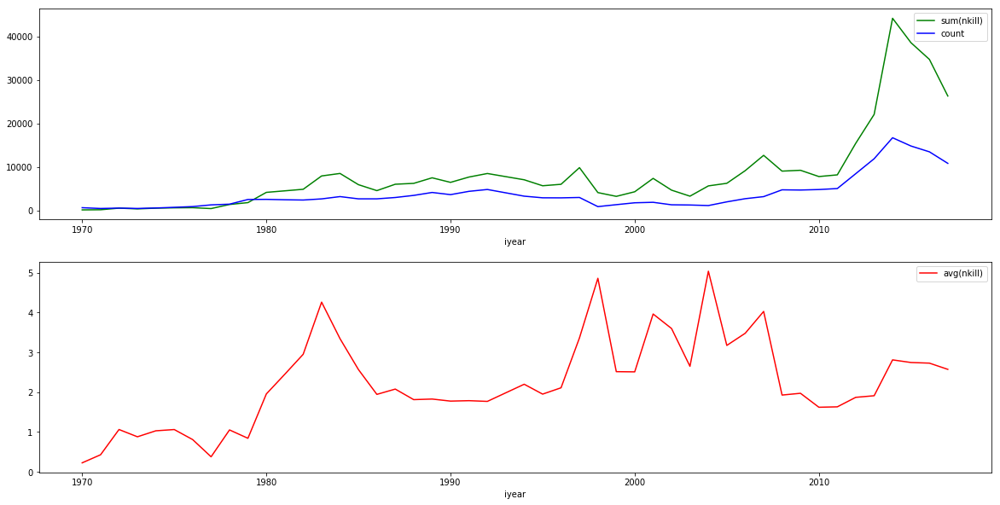

In [17]:
fig, ax = plt.subplots(2,1,figsize=(20,10))
gb = df_clean.select(["iyear","nkill"]).groupBy("iyear")
gb.sum("nkill").sort("iyear").toPandas().set_index('iyear').plot(ax=ax[0],kind='line',color='g')
gb.count().sort("iyear").toPandas().set_index('iyear').plot(ax=ax[0],kind='line',color='b')
gb.mean("nkill").sort("iyear").toPandas().set_index('iyear').plot(ax=ax[1],kind='line',color='r')


A fenti ábából az látszik, hogy 2010 környékén a terrorcselekmények száma és az általuk követelt áldozatok száma is rohamosan elkezdett nőni, majd 2015-től csökkenni kezdett ugyan, de még mindig jelentősen nagyobb, mint az ezt megelőző évtizedekben. A 80-as évektől kezdve megugrott a terrortámadásokban átlagosan meghaltak száma az addigi átlagos egyről 2-3 közé. Ez egybe csenghet afganisztán lerohanásával.

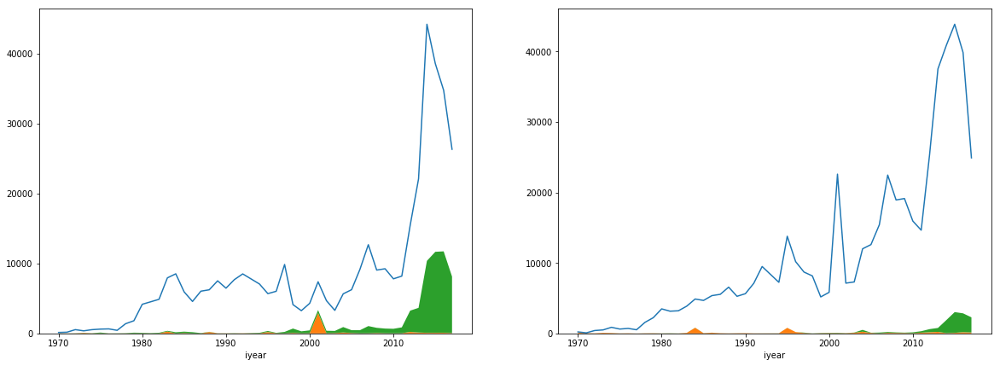

In [18]:
fig, ax = plt.subplots(1,2,figsize=(20,7))
gb = df_clean.select(["iyear","nkill","nkillus","nkillter"]).groupBy("iyear")
pdf = gb.sum("nkill","nkillus","nkillter").sort("iyear").toPandas()
pdf.set_index("iyear")["sum(nkill)"].plot(kind="line",ax=ax[0])
ax[0].stackplot(pdf.iyear,pdf["sum(nkillus)"],pdf["sum(nkillter)"])

gb = df_clean.select(["iyear","nwound","nwoundte","nwoundus"]).groupBy("iyear")
pdf = gb.sum("nwound","nwoundus","nwoundte").sort("iyear").toPandas()
pdf.set_index("iyear")["sum(nwound)"].plot(kind="line",ax=ax[1])
ax[1].stackplot(pdf.iyear,pdf["sum(nwoundus)"],pdf["sum(nwoundte)"])

A bal oldali ábrán az amerikai(narancs), illetve a terrorista(zöld) hallottak viszonya látszik az összes áldozathoz mérve.
Jobb oldalt ugyan ez a nem halálos áldozatokta.

In [19]:
def plot_scatters(df, columns, target_column,limit):
    number_of_columns = len(columns)
    plot_columns = 5
    whole_rows = int(number_of_columns / plot_columns)
    extrarow = 1 if number_of_columns % plot_columns > 0 else 0

    row = -1
    column = 0
    for i, col in enumerate(columns):
        last_number_of_columns = number_of_columns%plot_columns
        is_last_row = int(number_of_columns/plot_columns)*plot_columns <= i

        if(i%plot_columns == 0):
            row += 1
            column = 0
            if is_last_row:
                fig, ax = plt.subplots(1,last_number_of_columns,figsize=(20,4))
            else:
                fig, ax = plt.subplots(1,plot_columns,figsize=(20,4))
        else:
            column += 1
        schema = df.schema
        pdf = df.rdd \
            .filter(lambda x: (x[target_column] != None) and (x[col] != None)) \
            .toDF(schema) \
            .select([target_column,col]) \
            .toPandas() \
            .sample(limit,replace=True)
        
        x = pdf[target_column]
        y = pdf[col]
        result = pd.concat([x, y], axis=1)
        result.plot(x=target_column, y=col, kind="scatter",ax=ax[column])

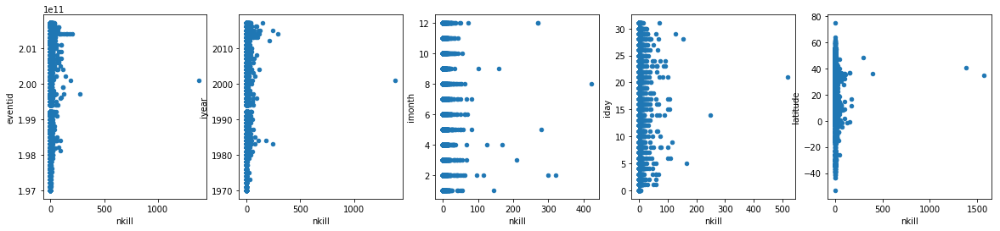

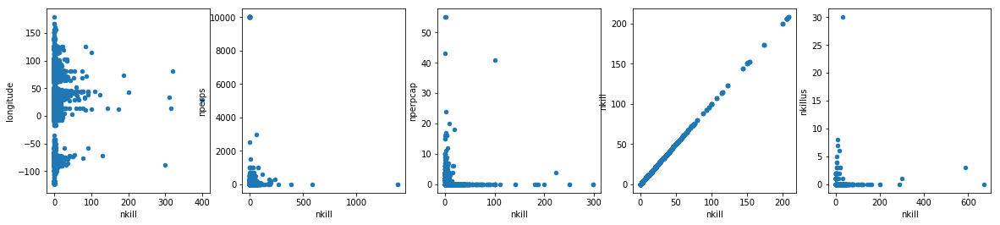

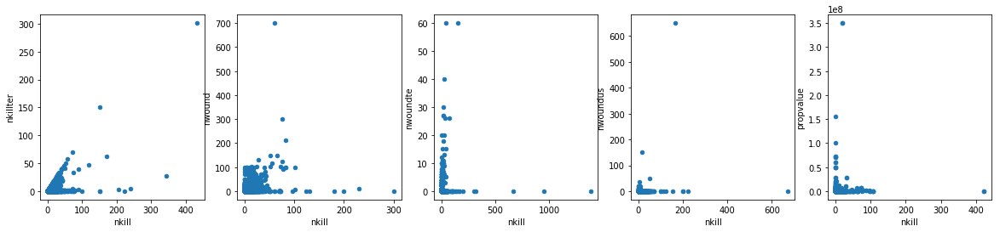

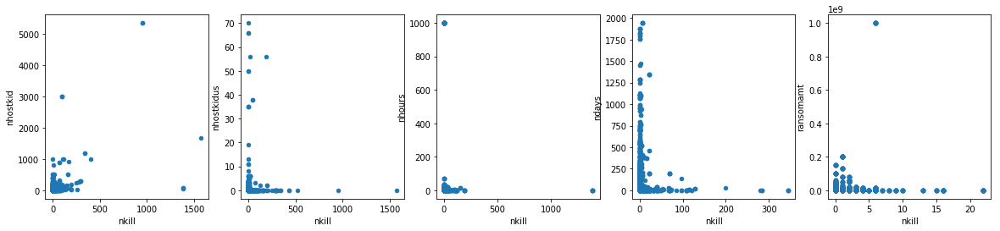

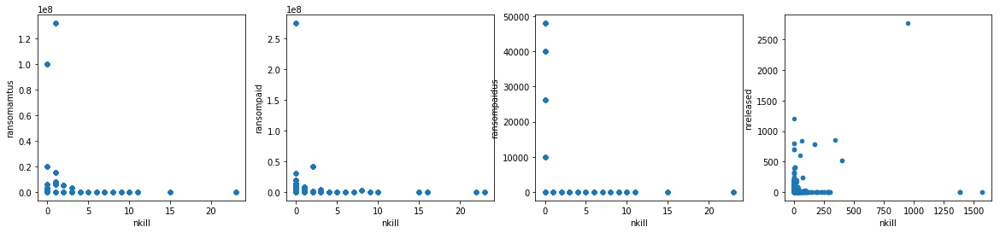

In [20]:
plot_scatters(df_clean,numeric_columns,"nkill",10000)

A régiós lebontás:

 3 részre bontható régiók szerint a terrortmadásokban átlagsan meghalók száma: Vannak a veszélyes régiók itt egy sikeres támadás átlagosan több mint 2 ember halálával végződik, ezután következne a mérsékelten veszélyes régiók itt átlagosan 1-2 ember hal bele a sikeres támadásokba, és végül a biztonságos régiók, ahol a sikeres terror támadásokba átlagosan kevesebb mint 1 ember hal meg.

Látható hogy Nyugat európában sok sikeres merénylet történik mégis igencsak kicsi az átlagosan meghalók száma. Gyanús hogy ez valamilyen európához kapcsolódó olyan teror csoport számlájára írható akik inkább létesítmények rombolásában jeleskedtek.

Sejtés a helyszíntől függ a halottak száma.

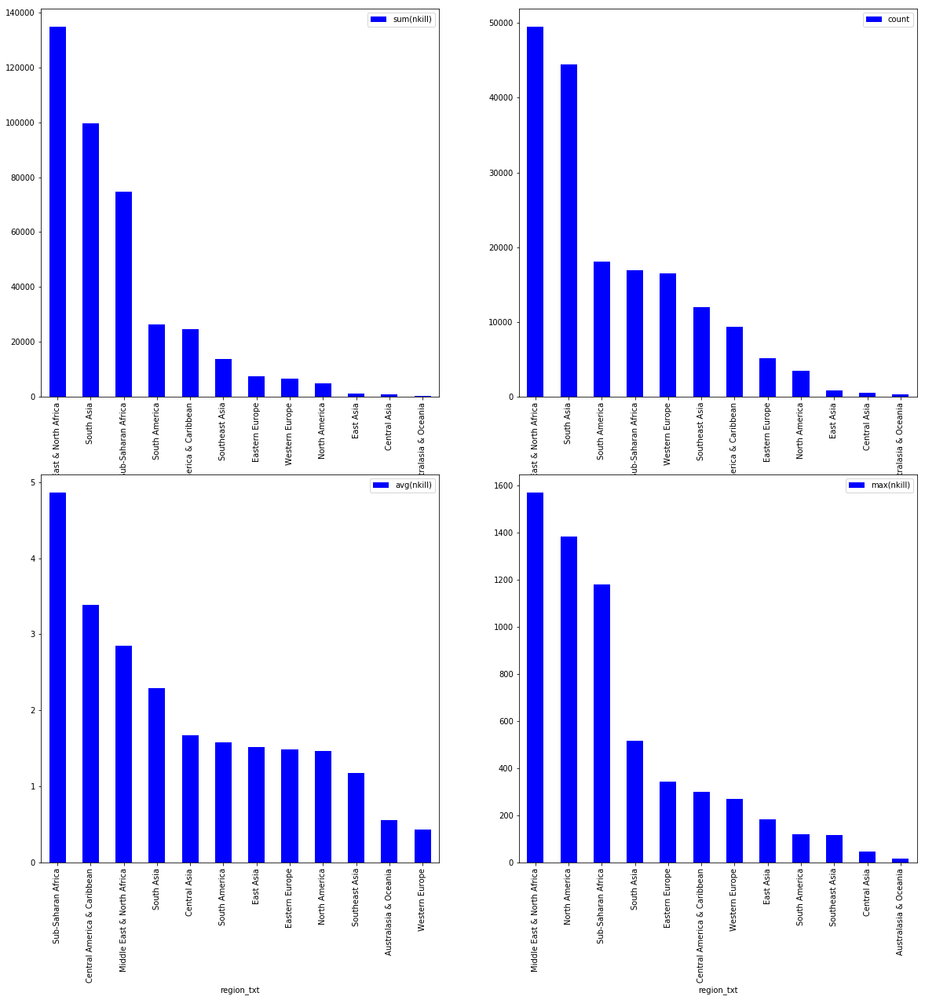

In [21]:
fig, ax = plt.subplots(2,2,figsize=(20,20))
gb = df_clean.select(["region_txt","nkill"]).groupBy("region_txt")
gb.sum("nkill").sort(desc("sum(nkill)")).toPandas().set_index('region_txt').plot(ax=ax[0,0],kind='bar',color='b')
gb.count().sort(desc("count")).toPandas().set_index('region_txt').plot(ax=ax[0,1],kind='bar',color='b')
gb.avg("nkill").sort(desc("avg(nkill)")).toPandas().set_index('region_txt').plot(ax=ax[1,0],kind='bar',color='b')
gb.max("nkill").sort(desc("max(nkill)")).toPandas().set_index('region_txt').plot(ax=ax[1,1],kind='bar',color='b')




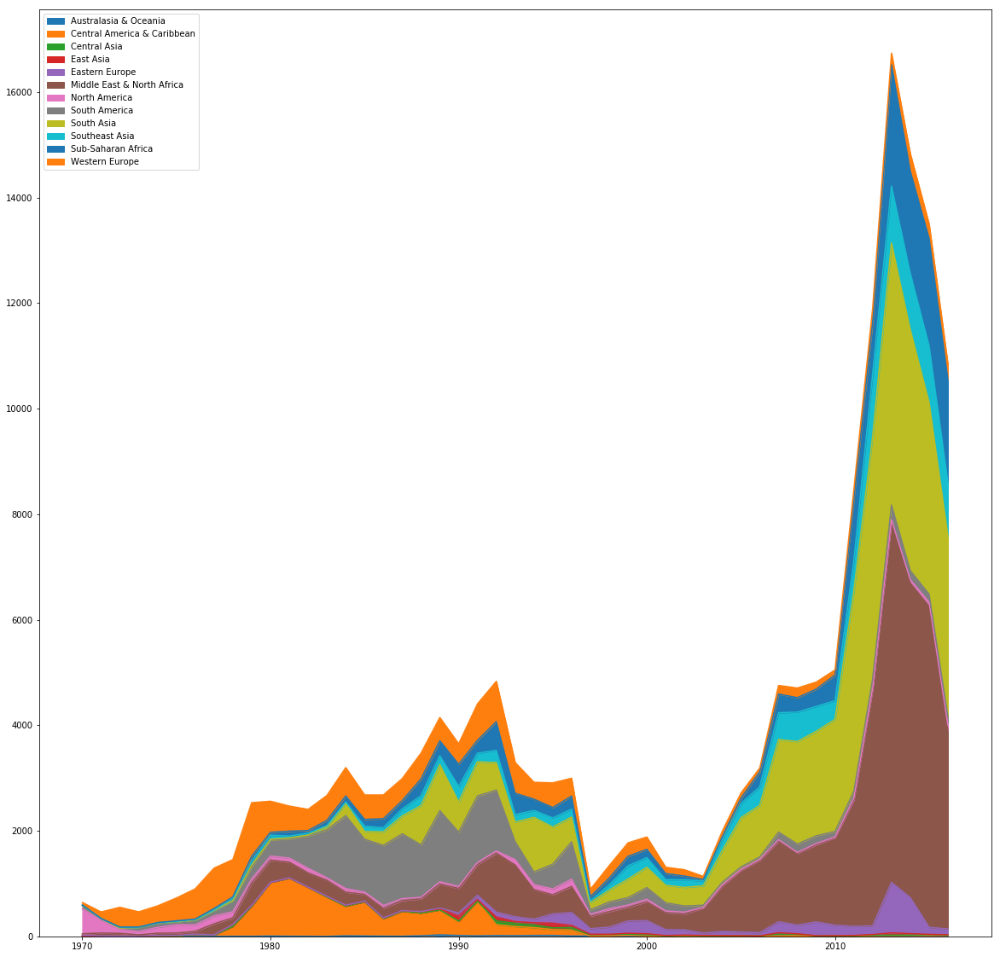

In [22]:
import numpy as np
gb = df_clean.sort('iyear').crosstab('iyear','region_txt').sort('iyear_region_txt').toPandas().set_index(np.arange(1970,2017,1)).plot(kind='area',figsize=(20,20))
#gb = df_clean.crosstab('iyear','region_txt').sort().show()

A régiós lebontás:

 3 részre bontható régiók szerint a terrortmadásokban átlagsan meghalók száma: Vannak a veszélyes régiók itt egy sikeres támadás átlagosan több mint 2 ember halálával végződik, ezután következne a mérsékelten veszélyes régiók itt átlagosan 1-2 ember hal bele a sikeres támadásokba, és végül a biztonságos régiók, ahol a sikeres terror támadásokba átlagosan kevesebb mint 1 ember hal meg.

Látható hogy Nyugat európában sok sikeres merénylet történik mégis igencsak kicsi az átlagosan meghalók száma. Gyanús hogy ez valamilyen európához kapcsolódó olyan teror csoport számlájára írható akik inkább létesítmények rombolásában jeleskedtek.

Sejtés a helyszíntől függ a halottak száma.
A régióknál láthatjuk, hogy kezdetben a terrortámadások nagyrésze a nyugathoz kapcsolódott, valamint dél-amerikáshoz ez a 2000-es évek közepére megváltozott és a közelkelet és dél-ázsia-ban nőtt meg a terror támadások mennyisége jelentősen.

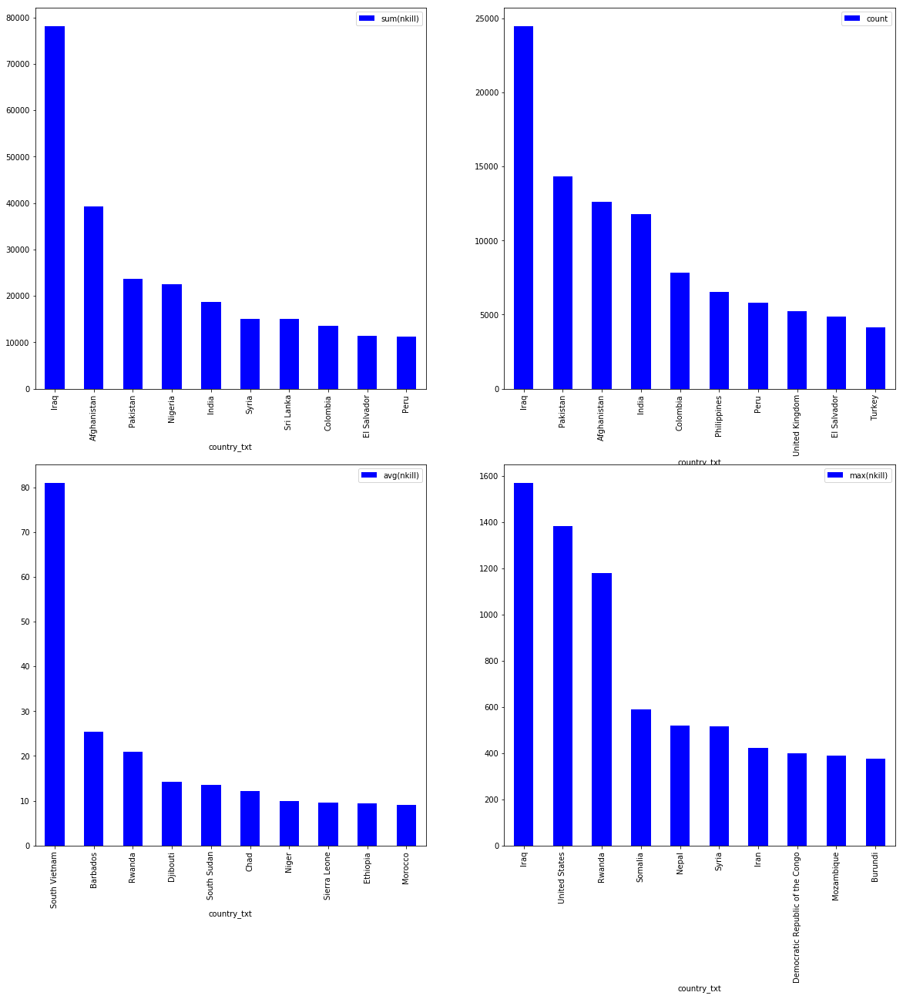

In [23]:
fig, ax = plt.subplots(2,2,figsize=(20,20))
gb = df_clean.select(["country_txt","nkill"]).groupBy("country_txt")
gb.sum("nkill").sort(desc("sum(nkill)")).limit(10).toPandas().set_index('country_txt').plot(ax=ax[0,0],kind='bar',color='b')
gb.count().sort(desc("count")).limit(10).toPandas().set_index('country_txt').plot(ax=ax[0,1],kind='bar',color='b')
gb.avg("nkill").sort(desc("avg(nkill)")).limit(10).toPandas().set_index('country_txt').plot(ax=ax[1,0],kind='bar',color='b')
gb.max("nkill").sort(desc("max(nkill)")).limit(10).toPandas().set_index('country_txt').plot(ax=ax[1,1],kind='bar',color='b')


Országok alapján csoportosítva a gyilkoságok számát azt láthatjuk, hogy a tipikus bukott álamok foglalják el az első helyeke, ez alól kivételt képez az USA amelyben a 911 dobta meg ezt a számot. Az átlagosan meghalt emberek száma kisebb álamokban a legnagyobb, ahol kevés terror támadás történik viszont ezek elég brutálisak.

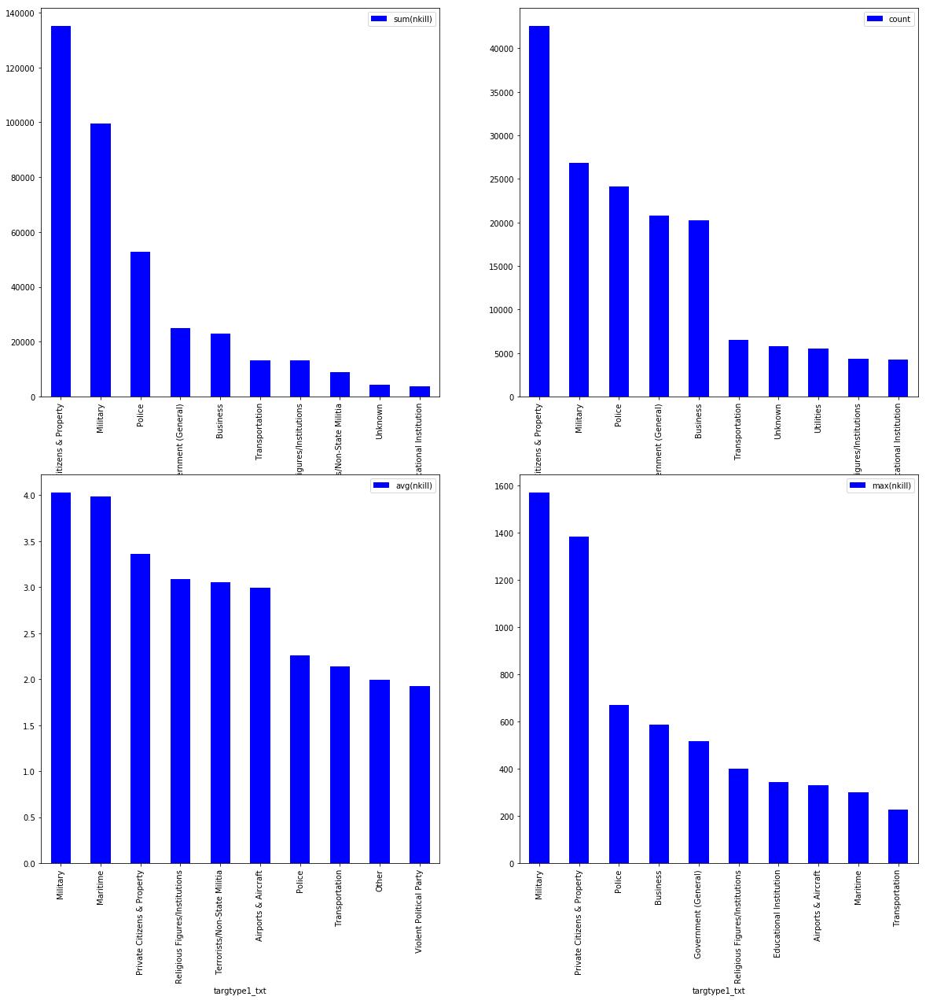

In [24]:
fig, ax = plt.subplots(2,2,figsize=(20,20))
gb = df_clean.select(["targtype1_txt","nkill"]).groupBy("targtype1_txt")
gb.sum("nkill").sort(desc("sum(nkill)")).limit(10).toPandas().set_index('targtype1_txt').plot(ax=ax[0,0],kind='bar',color='b')
gb.count().sort(desc("count")).limit(10).toPandas().set_index('targtype1_txt').plot(ax=ax[0,1],kind='bar',color='b')
gb.avg("nkill").sort(desc("avg(nkill)")).limit(10).toPandas().set_index('targtype1_txt').plot(ax=ax[1,0],kind='bar',color='b')
gb.max("nkill").sort(desc("max(nkill)")).limit(10).toPandas().set_index('targtype1_txt').plot(ax=ax[1,1],kind='bar',color='b')

A megtámadottak tipusától erőteljesen függ a megölt emberek száma. Elsőre az látható, hogy katonák ellen az eggyik leggyakoribb a terror támadás és ebben átlagosan többen is halnak meg. Továbbá látható, hogy a civilek ellen a leggyakrabb a támadás amibe ugyancsak átlagosan sok ember hal bele.


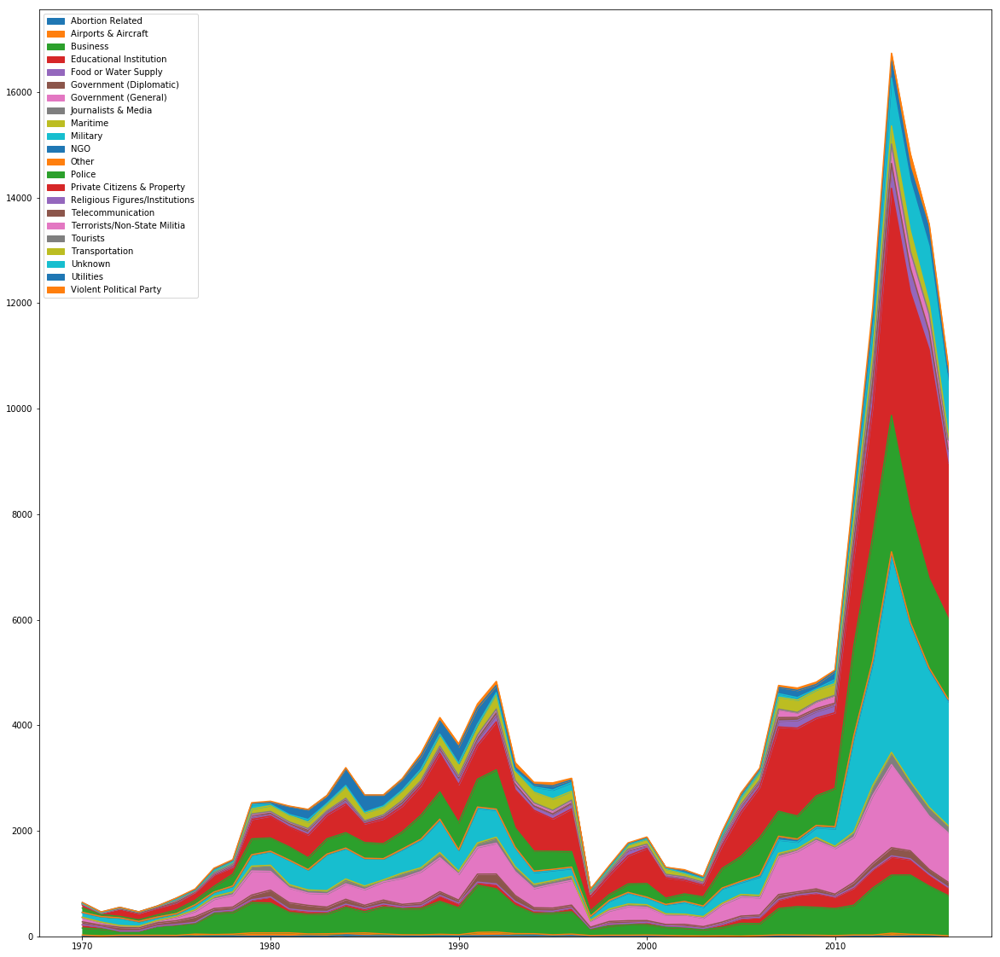

In [25]:
gb = df_clean.sort('iyear').crosstab('iyear','targtype1_txt').sort('iyear_targtype1_txt').toPandas().set_index(np.arange(1970,2017,1)).plot(kind='area',figsize=(20,20))


A megtámadottak tipusától erőteljesen függ a megölt emberek száma. Elsőre az látható, hogy katonák ellen az eggyik leggyakoribb a terror támadás és ebben átlagosan többen is halnak meg. Továbbá látható, hogy a civilek ellen a leggyakrabb a támadás amibe ugyancsak átlagosan sok ember hal bele.

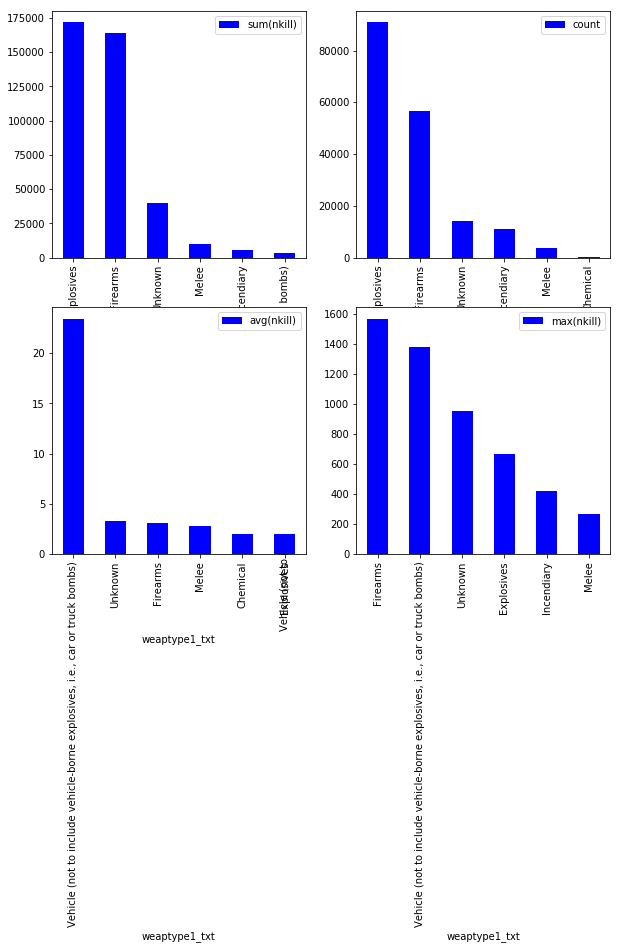

In [26]:
fig, ax = plt.subplots(2,2,figsize=(10,10))
gb = df_clean.select(["weaptype1_txt","nkill"]).groupBy("weaptype1_txt")
gb.sum("nkill").sort(desc("sum(nkill)")).limit(6).toPandas().set_index('weaptype1_txt').plot(ax=ax[0,0],kind='bar',color='b')
gb.count().sort(desc("count")).limit(6).toPandas().set_index('weaptype1_txt').plot(ax=ax[0,1],kind='bar',color='b')
gb.avg("nkill").sort(desc("avg(nkill)")).limit(6).toPandas().set_index('weaptype1_txt').plot(ax=ax[1,0],kind='bar',color='b')
gb.max("nkill").sort(desc("max(nkill)")).limit(6).toPandas().set_index('weaptype1_txt').plot(ax=ax[1,1],kind='bar',color='b')

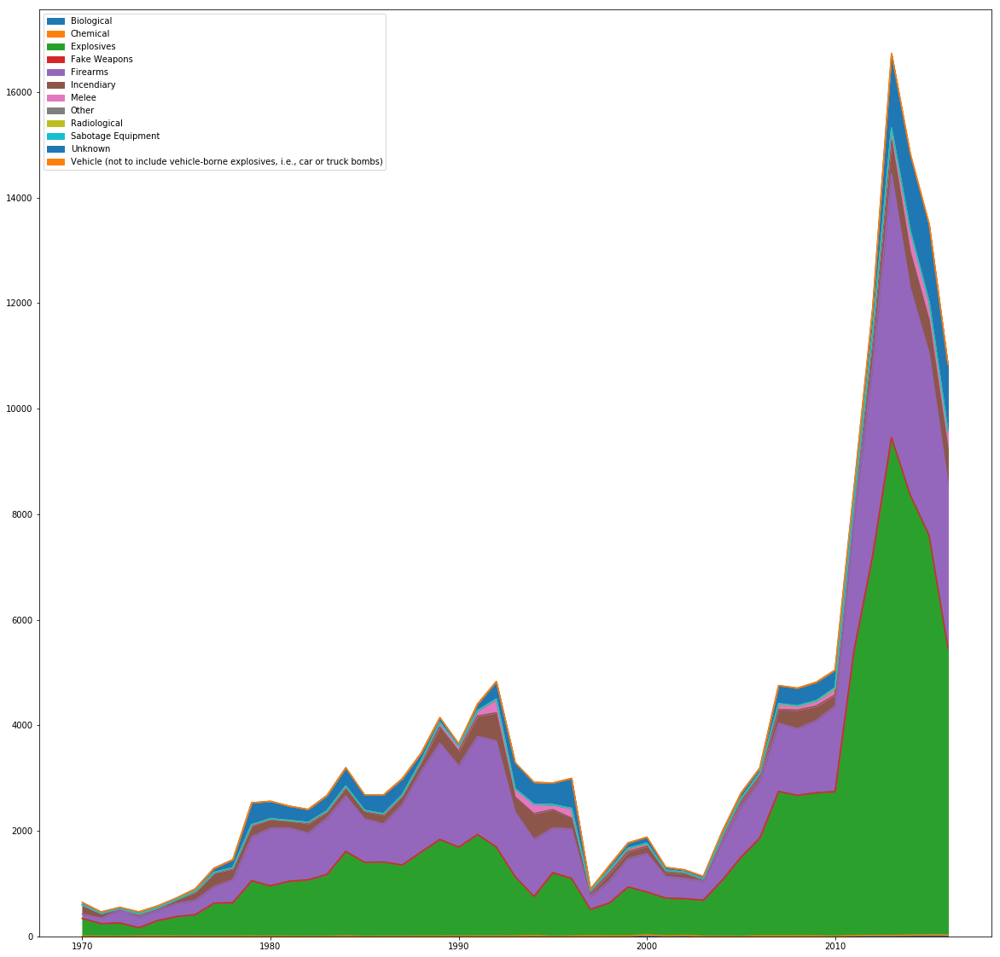

In [27]:
gb = df_clean.sort('iyear').crosstab('iyear','weaptype1_txt').sort('iyear_weaptype1_txt').toPandas().set_index(np.arange(1970,2017,1)).plot(kind='area',figsize=(20,20))


A támadásban használt fegyver erőteljesen meghatározza, hogy mennyi lesz a potenciális hlottak száma. Továbbá látszik, hogy mindig is a közelharc illetve lőfegyveres támadások voltak a leggyakrabbak, az összes támadás kb 80-90% ebből a két támadásból származott. S mivel ezek átlagosan 5 ember megölésével jártak így mindenképp érdemes lesz ebben az irányban tovább kutakodni.

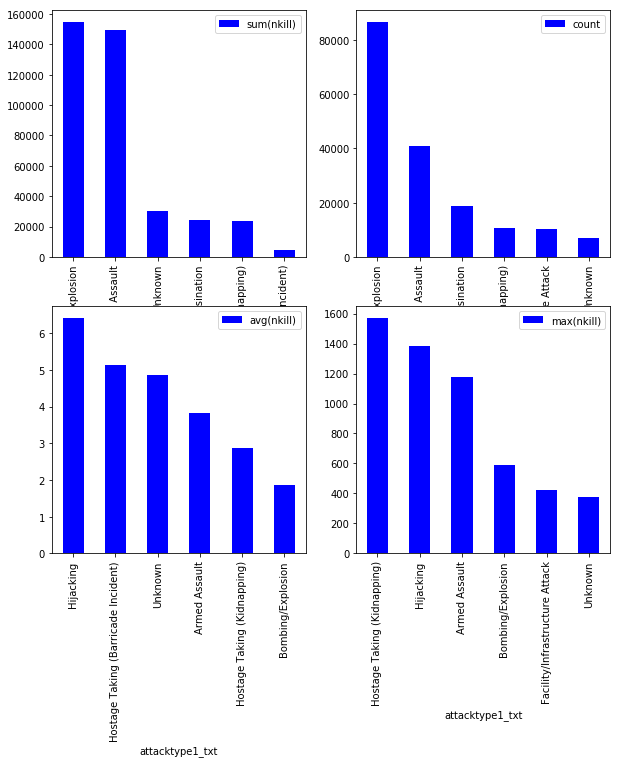

In [28]:
fig, ax = plt.subplots(2,2,figsize=(10,10))
gb = df_clean.select(["attacktype1_txt","nkill"]).groupBy("attacktype1_txt")
gb.sum("nkill").sort(desc("sum(nkill)")).limit(6).toPandas().set_index("attacktype1_txt").plot(ax=ax[0,0],kind='bar',color='b')
gb.count().sort(desc("count")).limit(6).toPandas().set_index("attacktype1_txt").plot(ax=ax[0,1],kind='bar',color='b')
gb.avg("nkill").sort(desc("avg(nkill)")).limit(6).toPandas().set_index("attacktype1_txt").plot(ax=ax[1,0],kind='bar',color='b')
gb.max("nkill").sort(desc("max(nkill)")).limit(6).toPandas().set_index("attacktype1_txt").plot(ax=ax[1,1],kind='bar',color='b')

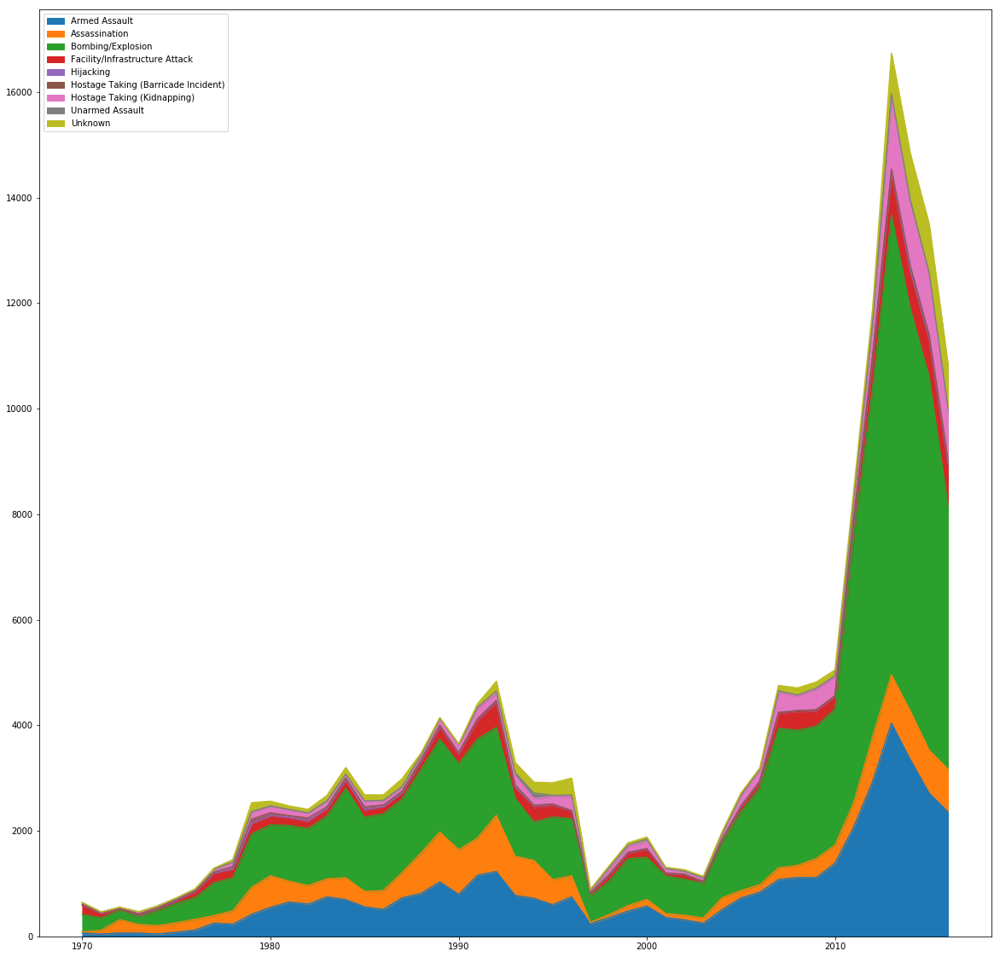

In [29]:
gb = df_clean.sort('iyear').crosstab('iyear','attacktype1_txt').sort('iyear_attacktype1_txt').toPandas().set_index(np.arange(1970,2017,1)).plot(kind='area',figsize=(20,20))


A legtöbb terror akció robbantásos kb kétszer több mint a második legtöbb, ennek ellenére éppen csak a legtöbb ember halt ebbe bele, s ami látszik, hogy a fegyveres rajtaütés szerű támadások során átlagosan 2x annyi ember hal meg mint robbantásos támadásokba. Továbbá látszik, hogy a gépeltérítéses támadásokba átlagosan sokan halnak meg, viszont az a gyanúm, hogy itt az átlag nem túl jó közelítés.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
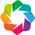

In [30]:
import math
import datashader as ds
from colorcet import fire,bmw,isolum,coolwarm,kgy,bkr
from datashader import transfer_functions as tf
import holoviews as hv
from functools import partial
from datashader.colors import colormap_select, Greys9
from IPython.core.display import HTML, display
background = "black"
cm = partial(colormap_select, reverse=(background!="black"))
import holoviews.operation.datashader as hd
from holoviews.streams import RangeXY
import geoviews as gv
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

In [31]:
def geographic_to_web_mercator_x(x_lon):
    if abs(x_lon) <= 180:
        num = x_lon * 0.01745329251994329
        x = 6378137.0 * num
        x_mercator = x
        return x_mercator
    else:
        print('Invalid coordinate values for conversion')    
def geographic_to_web_mercator_y(y_lat):
    if abs(y_lat) < 90:
        a = y_lat * 0.017453292519943295
        y_mercator = 3189068.5 * math.log((1.0 + math.sin(a)) / (1.0 - math.sin(a)))
        return y_mercator
    else:
        print('Invalid coordinate values for conversion')        

In [32]:
pdf = df_clean.select("latitude","longitude","nkill",'iyear').filter("abs(longitude) <= 180 and abs(latitude) <= 180").toPandas()
pdf["x"] = pdf["longitude"].apply(lambda x: geographic_to_web_mercator_x(x))
pdf["y"] = pdf["latitude"].apply(lambda y: geographic_to_web_mercator_y(y))
pdf.head()

,latitude,longitude,nkill,iyear,x,y
0,18.456792,-69.951164,1.0,1970,-7.786928e+06,2.091085e+06
1,19.371887,-99.086624,0.0,1970,-1.103027e+07,2.198769e+06
2,15.478598,120.599741,1.0,1970,1.342510e+07,1.744419e+06
3,37.997490,23.762728,NaN,1970,2.645255e+06,4.579071e+06
4,33.580412,130.396361,NaN,1970,1.451566e+07,3.972600e+06


In [33]:
%%opts QuadMesh [tools=['hover']] (alpha=0 hover_alpha=1 color='w')
from geoviews.tile_sources import CartoMidnight

tile_opts  = dict(width=1000,height=600,xaxis=None,yaxis=None,bgcolor='black',show_grid=False)
map_tiles  = CartoMidnight.opts( plot=tile_opts)
points     = hv.Points(pdf, ['x', 'y'])
taxi_trips = datashade(points, cmap = cm(bmw,0.4), how='eq_hist', width=1000, height=600, aggregator=ds.sum('nkill'))

(map_tiles * taxi_trips * hv.util.Dynamic(hd.aggregate(points, width=20, height=10, streams=[RangeXY], aggregator=ds.sum('nkill')), 
                               operation=hv.QuadMesh)).relabel("Dynamic hover")

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (nkill)

A fenti ábrán látható, hogy hol történtek terrortámadások az elmúlt 40-en évben. Itt látható hogy a közelkelet közép amerika és délkelet ázsiaban követelt a legtöbb áldozatot a terrorizmus.

In [34]:
pdf = df_clean.select("latitude","longitude","region").filter("abs(longitude) <= 180 and abs(latitude) <= 180").toPandas()
pdf["region"]=pdf["region"].astype("category")
pdf["x"] = pdf["longitude"].apply(lambda x: geographic_to_web_mercator_x(x))
pdf["y"] = pdf["latitude"].apply(lambda y: geographic_to_web_mercator_y(y))

In [35]:
%%opts QuadMesh [tools=['hover']] (alpha=0 hover_alpha=1 color='w')
from geoviews.tile_sources import CartoMidnight

tile_opts  = dict(width=1000,height=600,xaxis=None,yaxis=None,bgcolor='black',show_grid=False)
map_tiles  = CartoMidnight.opts( plot=tile_opts)
points     = hv.Points(pdf, ['x', 'y'])
taxi_trips = datashade(points, cmap = cm(bmw,0.4), width=1000, height=600, aggregator=ds.count_cat('region'))

(map_tiles * taxi_trips * hv.util.Dynamic(hd.aggregate(points, width=20, height=10, streams=[RangeXY], aggregator=ds.mean()), 
                               operation=hv.QuadMesh)).relabel("Régiók")

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (latitude)

Régiós bontásban az látható, hogy a támadások minden régióban eggyes területek környékére koncentrálódnak, és leginkább eggyes országokhoz kapcsolódnak.

In [36]:
%%opts QuadMesh [tools=['hover']] (alpha=0 hover_alpha=1 color='w')
from geoviews.tile_sources import CartoMidnight

pdf = df.select("latitude","longitude","attacktype1").filter("abs(longitude) <= 180 and abs(latitude) <= 180").toPandas()
pdf["attacktype1"]=pdf["attacktype1"].astype("category")
pdf["x"] = pdf["longitude"].apply(lambda x: geographic_to_web_mercator_x(x))
pdf["y"] = pdf["latitude"].apply(lambda y: geographic_to_web_mercator_y(y))

tile_opts  = dict(width=1000,height=600,xaxis=None,yaxis=None,bgcolor='black',show_grid=False)
map_tiles  = CartoMidnight.opts( plot=tile_opts)
points     = hv.Points(pdf, ['x', 'y'])
taxi_trips = datashade(points, cmap = bmw, how='eq_hist', width=1000, height=600, aggregator=ds.count_cat('attacktype1'))

(map_tiles * taxi_trips).relabel("Támadás tipusa")

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [x,y]   (R,G,B,A)

A támadások tipusának megfigyelésével azt vehetjük észre, hogy eggyes területeken általában meghatározzák, hogy ott milyen támadási típus várható.

In [37]:
import holoviews as hv, geoviews as gv, dask.dataframe as dd, cartopy.crs as crs
from colorcet import fire
from holoviews.operation.datashader import datashade

options = dict(width=700, height=600, xaxis=None, yaxis=None, bgcolor='black')
points = hv.Points(pdf, ['x', 'y'])
taxi_trips = datashade(points, x_sampling=1, y_sampling=1, cmap=fire).opts(plot=options)
url = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{Z}/{Y}/{X}.jpg'
tiles = gv.WMTS(url, crs=crs.GOOGLE_MERCATOR)
tiles * taxi_trips

:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [x,y]   (R,G,B,A)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
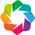

In [38]:
import numpy as np
import pandas as pd
import holoviews as hv
hv.extension('bokeh')

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
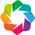

:HoloMap   [region_txt,iyear]
   :Overlay
      .Bars.I    :Bars   [imonth]   (sum(nkill))
      .Scatter.I :Scatter   [imonth]   (sum(nkill))

In [39]:
%%opts Overlay [width=700 height=400 show_frame=False]
%%opts Text (text_font_size='13px')
%output max_frames=10000
hv.extension('bokeh')

macro_df = df.select('iyear','imonth','region_txt','nkill').groupBy('iyear','imonth','region_txt').sum('nkill').orderBy("imonth").toPandas()
key_dimensions   = [('imonth', 'Month'), ('region_txt', 'Region'),('iyear', 'Year')]
value_dimensions = [('sum(nkill)', 'Number of deaths')]
macro = hv.Table(macro_df, key_dimensions, value_dimensions)

gdp_curves = macro.to.bars('Month', 'Number of deaths')
gdp_unem_scatter = macro.to.scatter('Month', ['Number of deaths'])
gdp_curves * gdp_unem_scatter

A megfigyelt régiók eggyikében sem befolyásolta a terrortámadásokban elhunytak össz számát hogy milyen hónapban történt a támadás.

In [40]:
categorical_text_columns= ['country_txt','region_txt','alternative_txt','attacktype1_txt','attacktype2_txt','attacktype3_txt',
                        'targtype1_txt','targsubtype1_txt','natlty1_txt','targtype2_txt','targsubtype2_txt','natlty2_txt',
                        'targtype3_txt','targsubtype3_txt','natlty3_txt','claimmode_txt','claimmode2_txt','claimmode3_txt',
                        'weaptype1_txt','weapsubtype1_txt','weaptype2_txt','weapsubtype2_txt','weaptype3_txt','weapsubtype3_txt',
                        'weaptype4_txt','weapsubtype4_txt','propextent_txt','hostkidoutcome_txt','gname']


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
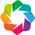

:HoloMap   [region_txt,iyear]
   :Overlay
      .Bars.I    :Bars   [attacktype1_txt]   (sum(nkill))
      .Scatter.I :Scatter   [attacktype1_txt]   (sum(nkill))

In [41]:
%%opts Overlay [width=700 height=400 show_frame=False]
%%opts Text (text_font_size='13px')
%output max_frames=10000
hv.extension('bokeh')

macro_df2 = df_clean.select('iyear','attacktype1_txt','region_txt','nkill').groupBy('iyear','attacktype1_txt','region_txt').sum('nkill').orderBy("attacktype1_txt").toPandas()
key_dimensions   = [('attacktype1_txt', 'Type of Attack'), ('region_txt', 'Region'),('iyear', 'Year')]
value_dimensions = [('sum(nkill)', 'Number of deaths')]
macro = hv.Table(macro_df2, key_dimensions, value_dimensions)

gdp_curves = macro.to.bars('Type of Attack', 'Number of deaths')
gdp_unem_scatter = macro.to.scatter('Type of Attack', ['Number of deaths'])
gdp_curves * gdp_unem_scatter

Közép amerikában a fegyveres rajtaütésekben halnak meg a legtöbben, különösen a 80-as évek elején. Ugyan ez tapasztalható dél-amerikában is. A közelkeleten a robbantásos merényletek a legmeghatározóbbak 2003-at követően. A szubszaharai térségben is elsődleges támadási forma a fegyveres rajtaütés.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
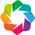

:HoloMap   [attacktype1_txt,region_txt]
   :Overlay
      .Bars.I    :Bars   [weaptype1_txt]   (avg(nkill))
      .Scatter.I :Scatter   [weaptype1_txt]   (avg(nkill))

In [83]:
%%opts Overlay [width=700 height=400 show_frame=False]
%%opts Text (text_font_size='13px')
%output max_frames=10000
hv.extension('bokeh')

macro_df2 = df_clean.select('weaptype1_txt','attacktype1_txt','region_txt','nkill').groupBy('weaptype1_txt','attacktype1_txt','region_txt').avg('nkill').orderBy("weaptype1_txt").toPandas()
key_dimensions   = [('attacktype1_txt', 'Type of Attack'), ('region_txt', 'Region'),('weaptype1_txt', 'Weap')]
value_dimensions = [('avg(nkill)', 'Number of deaths')]
macro = hv.Table(macro_df2, key_dimensions, value_dimensions)

gdp_curves = macro.to.bars('Weap', 'Number of deaths')
gdp_unem_scatter = macro.to.scatter('Weap', ['Number of deaths'])
gdp_curves * gdp_unem_scatter

Az elmondható, hogy a fegyveres rajtaütésekben átlagosan a szubszaharai térségben halnak bele, történjen az akármilyen fegyverrel. Továbbá kelet ázsiában is sokan halnak meg ilyen módon átlagosan. A kivégzéses terror akciók átlagosan kevés emberrel végeznek ez alól az autóba rejtett bombás támadások követelnek, átlagosan több ember életet, ami nyugat európában alkalmaznak. Az infrastruktúra ellen elkövetett merénylet átlagosan nagyon kevés ember éeletet követel. A gépeltérítések magas átlagos halálos áldozat számára a 9-11 lehet a válasz ugyanis, azon kívűl észak amerikán kívűl alacsony a meghaltak széma átlagosan, ebben a támadástípusban.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
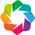

:HoloMap   [weaptype1_txt,iyear]
   :Overlay
      .Bars.I    :Bars   [attacktype1_txt]   (avg(nkill))
      .Scatter.I :Scatter   [attacktype1_txt]   (avg(nkill))

In [43]:
%%opts Overlay [width=700 height=400 show_frame=False]
%%opts Text (text_font_size='13px')
%output max_frames=10000
hv.extension('bokeh')

macro_df2 = df_clean.select('weaptype1_txt','attacktype1_txt','iyear','nkill').groupBy('weaptype1_txt','attacktype1_txt','iyear').avg('nkill').orderBy("attacktype1_txt").toPandas()
key_dimensions   = [('attacktype1_txt', 'Type of Attack'),('weaptype1_txt', 'Weapon Type'),('iyear','Year')]
value_dimensions = [('avg(nkill)', 'Avarge number of deaths')]
macro = hv.Table(macro_df2, key_dimensions, value_dimensions)

gdp_curves = macro.to.bars('Type of Attack', 'Avarge number of deaths')
gdp_unem_scatter = macro.to.scatter('Type of Attack', ['Avarge number of deaths'])
gdp_curves * gdp_unem_scatter

Megfigyelhető hogy közelharci fegyverrel átlagosan egyre kevesebb embert ölnek meg

In [140]:

from pyspark.sql.functions import col, when, lit
from pyspark.sql.functions import udf
from pyspark.sql.types import StringType

In [141]:
select=["iyear", "imonth", "iday", "latitude", "longitude","nperps","nperpcap","nkill","nkillus",
                   "nkillter","nwound","nwoundte","nwoundus","propvalue",'crit1','crit2','crit3','doubtterr','multiple','country_txt','region_txt',
                   'targtype1_txt','vicinity','specificity','success','attacktype1_txt','natlty1_txt','claimmode_txt','weaptype1_txt','gname',
                    'suicide','guncertain1']

our_intrest=["iyear","nperps","nperpcap","nkill",
                   "nkillter","nwound","nwoundte",'crit1','crit2','crit3','doubtterr','multiple','country_txt','region_txt',
                   'targtype1_txt','specificity','success','attacktype1_txt','natlty1_txt','claimmode_txt','weaptype1_txt','gname',
                    'suicide']
proba=["nkill",'success','suicide']
df_proba=df_clean.select(*proba)
df_clean_1=df_clean.select(*select)
#df_clean_1=df_clean_1.withColumn("More", when((col("nkill")>10) ,lit(1)).otherwise(lit(0)))
df_intrest=df_clean.select(*our_intrest)
#df_clean_1=df_clean_1.drop("nkill")
#df_clean_1.drop('nkillus')
df_clean_1

DataFrame[iyear: int, imonth: int, iday: int, latitude: double, longitude: double, nperps: double, nperpcap: double, nkill: double, nkillus: double, nkillter: double, nwound: double, nwoundte: double, nwoundus: double, propvalue: double, crit1: int, crit2: int, crit3: int, doubtterr: double, multiple: double, country_txt: string, region_txt: string, targtype1_txt: string, vicinity: int, specificity: double, success: int, attacktype1_txt: string, natlty1_txt: string, claimmode_txt: string, weaptype1_txt: string, gname: string, suicide: int, guncertain1: double]

In [142]:
df_proba=df_proba.withColumn("More", when((col("nkill")>0) ,lit(1)).otherwise(lit(0)))

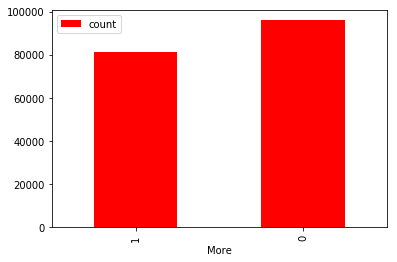

In [143]:
df_proba.groupBy("More").count().toPandas().set_index('More').plot(kind='bar',color='r')

In [144]:
from pyspark.ml import Pipeline
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.feature import StringIndexer, VectorIndexer, OneHotEncoder, VectorAssembler, IndexToString
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

In [ ]:
df_proba.dropna()
df_proba.drop('nkill')
[df_train,df_test]=df_proba.randomSplit([0.7,0.3])
#succes_encoder = OneHotEncoder(inputCol="succes", outputCol="succesVec")
assembler = VectorAssembler(inputCols=["success","suicide"],outputCol="features")
rf = RandomForestClassifier(labelCol="More", featuresCol="features",numTrees = 40, featureSubsetStrategy="auto",impurity="gini",maxDepth=4,maxBins=20)
pipeline = Pipeline(stages=[assembler, rf]) 
model=pipeline.fit(df_train)
predictions = model.transform(df_test)
predictions.columns
predictions.select("prediction", "More", "features").show(5)
predictions = predictions.select(col("More").cast("Float"),col("prediction"))
evaluator = MulticlassClassificationEvaluator(labelCol="More", predictionCol="prediction", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)
print("Test Error = %g" % (1.0 - accuracy))
rfModel = model.stages[1]
print(rfModel)  # summary only

evaluator = MulticlassClassificationEvaluator(labelCol="More", predictionCol="prediction", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)
print("Accuracy = %g" % accuracy)
 
evaluatorf1 = MulticlassClassificationEvaluator(labelCol="More", predictionCol="prediction", metricName="f1")
f1 = evaluatorf1.evaluate(predictions)
print("f1 = %g" % f1)
print(model.extractParamMap)
print(rfModel.toDebugString)

+----------+----+---------+
|prediction|More| features|
+----------+----+---------+
|       0.0|   0|(2,[],[])|
|       0.0|   0|(2,[],[])|
|       0.0|   0|(2,[],[])|
|       0.0|   0|(2,[],[])|
|       0.0|   0|(2,[],[])|
+----------+----+---------+
only showing top 5 rows

Test Error = 0.425339
RandomForestClassificationModel (uid=RandomForestClassifier_0bd7b42da660) with 40 trees


IllegalArgumentException: 'Field "features" does not exist.\nAvailable fields: nkill, success, suicide, More'

In [116]:
#for col in df_clean_1.columns[5:]:
 #   print(col, df_clean_1.select(col).distinct().count())


                       



In [117]:
#df_clean_1=df_clean_1.drop('propvalue')
#gname2 = df_clean_1.groupBy("gname").sum("nkill")

In [118]:

 
COUNT_THRESHOLD = 1000
 

gname2 = df_intrest.groupBy("gname").count()
df_intrest = df_intrest.join(gname2, "gname", "inner")
 
def convertMinority(originalCol, colCount):
    if colCount > COUNT_THRESHOLD:
        return originalCol
    else:
        return 'MinorityCategory'
    
createNewColFromTwo = udf(convertMinority, StringType())
df_intrest = df_intrest.withColumn('gname_reduced', createNewColFromTwo(df_intrest["gname"], df_intrest['count']))
df_intrest = df_intrest.drop('gname')
df_intrest = df_intrest.drop('count')
country = df_intrest.groupBy("country_txt").count()
df_intrest = df_intrest.join(country, "country_txt", "inner")
df_intrest = df_intrest.withColumn('country_reduced', createNewColFromTwo(df_intrest["country_txt"], df_intrest['count']))
df_intrest = df_intrest.drop('country_txt')
df_intrest = df_intrest.drop('count')


natly = df_intrest.groupBy("natlty1_txt").count()
df_intrest = df_intrest.join(natly, "natlty1_txt", "inner")
df_intrest = df_intrest.withColumn('natlty_reduced', createNewColFromTwo(df_intrest["natlty1_txt"], df_intrest['count']))
df_intrest = df_intrest.drop('natlty1_txt')
df_intrest = df_intrest.drop('count')


In [119]:
for col in df_intrest.columns[5:]:
    print(col, df_intrest.select(col).distinct().count())

nwound 239
nwoundte 45
crit1 2
crit2 2
crit3 2
doubtterr 4
multiple 3
region_txt 12
targtype1_txt 22
specificity 4
success 2
attacktype1_txt 9
claimmode_txt 11
weaptype1_txt 12
suicide 2
gname_reduced 21
country_reduced 36
natlty_reduced 36
